In [25]:
import org.jetbrains.kotlinx.dl.api.summary.printSummary
import org.jetbrains.kotlinx.dl.impl.preprocessing.image.ImageConverter
import org.jetbrains.kotlinx.dl.onnx.inference.ONNXModelHub
import org.jetbrains.kotlinx.dl.onnx.inference.ONNXModels
import java.io.File
import javax.imageio.ImageIO

In [26]:
val modelHub = ONNXModelHub(cacheDirectory = File("../../../cache/pretrainedModels"))
val detectionModel = ONNXModels.ObjectDetection.SSD.pretrainedModel(modelHub)

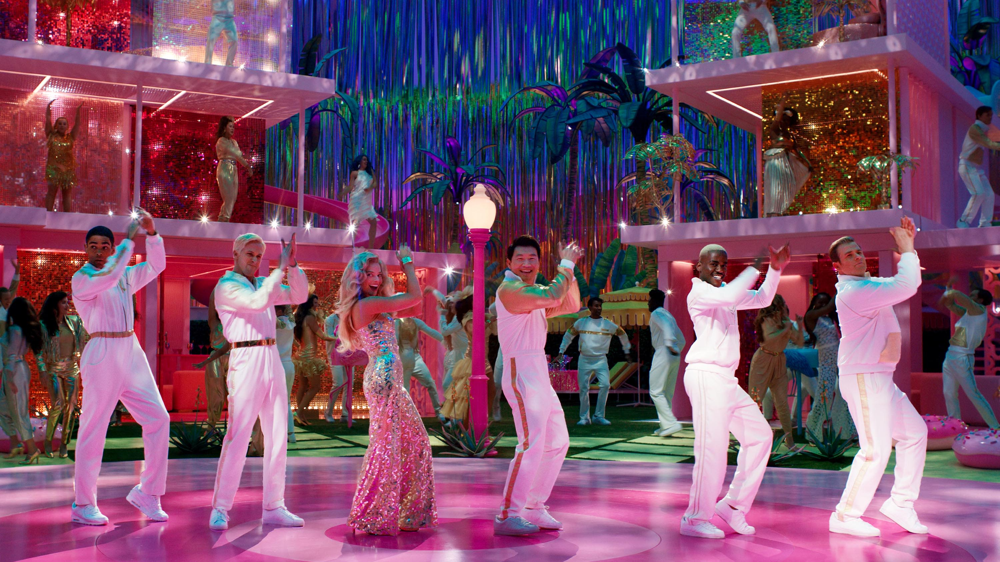

In [27]:
import javax.imageio.ImageIO

val PATH_TO_IMAGE = "../src/main/resources/barbie.png"
val image = ImageIO.read(File(PATH_TO_IMAGE))

DISPLAY(image)

In [28]:
val detectedObjects = detectionModel.detectObjects(image, topK = 10)

detectedObjects.forEach {
    println("Found ${it.label} with probability ${it.probability}")
}

Found person with probability 0.9200462
Found person with probability 0.8348928
Found person with probability 0.8111157
Found person with probability 0.69907737
Found person with probability 0.6704777
Found person with probability 0.64912397
Found person with probability 0.41410798
Found person with probability 0.40928212
Found person with probability 0.3924804
Found person with probability 0.37005147


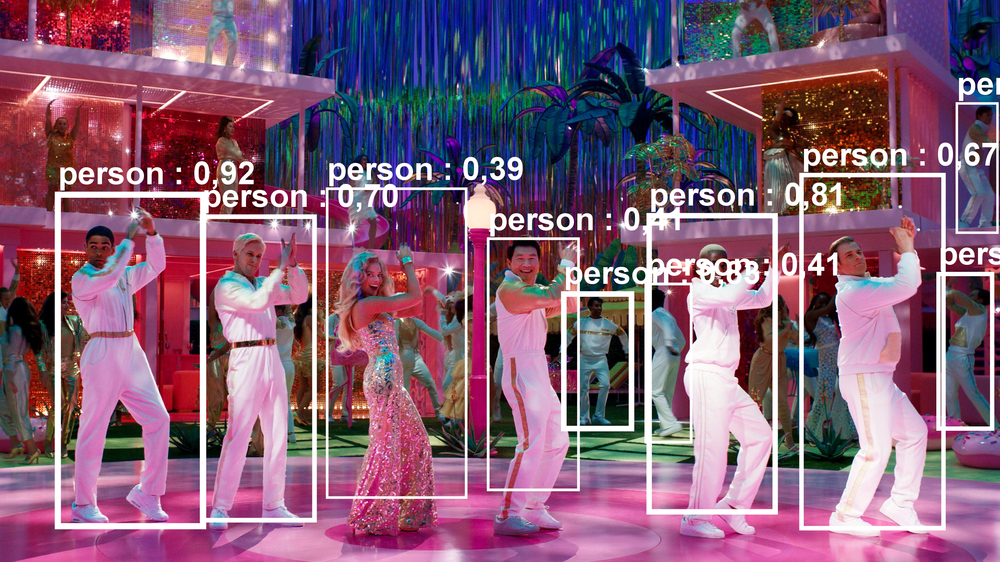

In [29]:
val streetImageWithRectangles = drawRectanglesForDetectedObjects(image, detectedObjects)
DISPLAY(streetImageWithRectangles)

In [30]:
detectionModel.close()